## Data exploration of the dataset (features, shocks location...)

In [2]:
from IPython.display import Image, display

import os

from datetime import datetime
from datetime import date


from scipy.ndimage import gaussian_filter
import numpy as np
import sys

sys.path.append('../scripts')

import matplotlib.pyplot as plt
import geopandas as gpd

from data_download import download_data
from load_data import load_files, load_earthquakes_data

from preprocess_data import clean_db_data, filter_earthquake_database

from other_functions import select_big_earthquakes,valid_year, grid_cell, get_grid_cell, bayes_rule

from plot_data import custom_marker_size

from plot_data import plot_earthquakes_time_histogram,plot_earthquakes_mag_histogram,plot_earthquakes_mag_histogram_bins,plot_earthquakes_depth_histogram
from plot_data import plot_earthquakes_depth_histogram_bins,plot_earthquakes_depth_histogram,plot_earthquakes_depth_histogram_log, custom_marker_size, plot_cells_big_earthquake
from plot_data import plot_earthquakes_on_worldmap


In [3]:
usgs_folder_path="../ressources/usgs"
pop_folder_path ="../ressources/population"
current_year = datetime.now().year
current_directory = os.getcwd()
world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))

C:\Users\33626\AppData\Local\Temp\ipykernel_5364\191236042.py:5: FutureWarning: The geopandas.dataset module is deprecated and will be removed in GeoPandas 1.0. You can get the original 'naturalearth_lowres' data from https://www.naturalearthdata.com/downloads/110m-cultural-vectors/.
  world = gpd.read_file(gpd.datasets.get_path('naturalearth_lowres'))


In [4]:
# Useful variables
prev_years = 53
mag_outlier_threshold = 3.5
min_mag = 5.
# BigShock_min_mag = 5.4
depth_drop_range = [120,450]

n_big_earthquakes = 15

threshold_year = 1995
date_threshold = date(threshold_year, 1, 1)

earth_area = 510.1e6 #square km
earth_circ = 40075 #km
min_latitude, max_latitude, min_longitude, max_longitude  = -90, 90,- 180 , 180

large_cell_cluster_size = 60 #needs to find optimal value here for cells clustering

# bayes_rule_res = bayes_rule(0.12, 0.34, 0.84)


---
step 1 : load data

In [ ]:
download_data(prev_years, folder_path=usgs_folder_path)
# clean_pop_database(folder_path=pop_folder_path) #folder_path=pop_folder_path

In [6]:
data_files = load_files("earthquake",folder_path=usgs_folder_path)
fyear = valid_year(data_files, fyear = threshold_year)

In [7]:
earthquake_db = load_earthquakes_data(start_year = fyear, end_year = current_year, files_list = data_files, folder_path=usgs_folder_path)
initial_size = earthquake_db.size

using 50 files over 29 years.



### Dataset Description

In [8]:
earthquake_db.describe()

,latitude,longitude,depth,mag,horizontalError,depthError,magError,timestamp
count,715654.000000,715654.000000,715654.000000,715654.000000,276957.000000,4.410710e+05,275476.000000,7.156540e+05
mean,18.518491,-18.268009,56.739714,3.805861,5.632999,1.532100e+01,0.152756,1.276290e+09
std,30.542348,121.538264,102.697411,0.863419,4.747153,2.834509e+03,0.212314,2.558969e+08
min,-84.422000,-179.999700,-3.740000,0.700000,0.000000,-1.000000e+00,0.000000,7.889185e+08
25%,-5.553000,-122.328125,10.000000,2.990000,1.180000,1.250000e+00,0.080000,1.074521e+09
50%,19.730000,-66.079550,22.470000,4.000000,5.320000,3.600000e+00,0.126000,1.274930e+09
75%,40.783425,121.028000,51.300000,4.500000,8.700000,8.560000e+00,0.178000,1.512298e+09
max,87.386000,180.000000,735.800000,9.100000,99.000000,1.773552e+06,5.670000,1.701088e+09


In [9]:
earthquake_db.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 715654 entries, 0 to 9523
Data columns (total 12 columns):
 #   Column           Non-Null Count   Dtype  
---  ------           --------------   -----  
 0   time             715654 non-null  object 
 1   latitude         715654 non-null  float64
 2   longitude        715654 non-null  float64
 3   depth            715654 non-null  float64
 4   mag              715654 non-null  float64
 5   id               715654 non-null  object 
 6   horizontalError  276957 non-null  float64
 7   depthError       441071 non-null  float64
 8   magError         275476 non-null  float64
 9   date             715654 non-null  object 
 10  timestamp        715654 non-null  float64
 11  nearest_area     712476 non-null  object 
dtypes: float64(8), object(4)
memory usage: 71.0+ MB


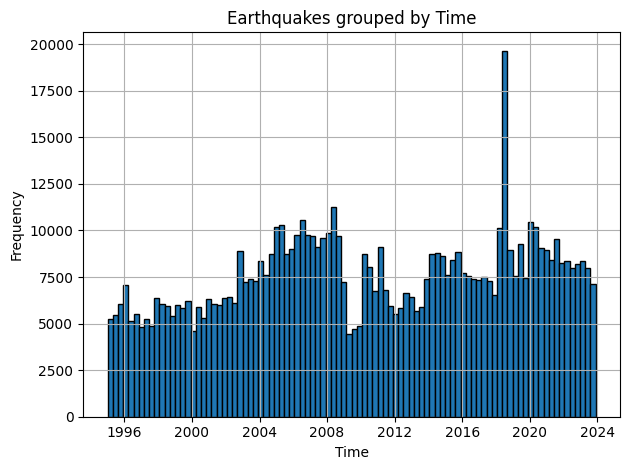

In [10]:
plot_earthquakes_time_histogram(earthquake_db)

### Error values Filtering

In [11]:
earthquake_db = clean_db_data(earthquake_db,date_threshold,mag_outlier_threshold,min_mag)
earthquake_db.shape

filtering earthquake database for earthquakes after 1995-01-01 and ensure absence of mistakes in database by dropping earthquakes of mag < 3.5...

filtering 'X_Error' columns. If an 'X_Error' value is not a NaN and outside 3 sigma, we drop the row (inaccurate data). NaN values are replaced by median:

horizontalError old nan value : 284908
median error in horizontalError : 7.9
horizontalError new nan value : 0
-----------------------------------
depthError old nan value : 184622
median error in depthError : 5.911
depthError new nan value : 0
-----------------------------------
magError old nan value : 273096
median error in magError : 0.118
magError new nan value : 0
-----------------------------------


(432422, 10)

### Magnitude Distribution

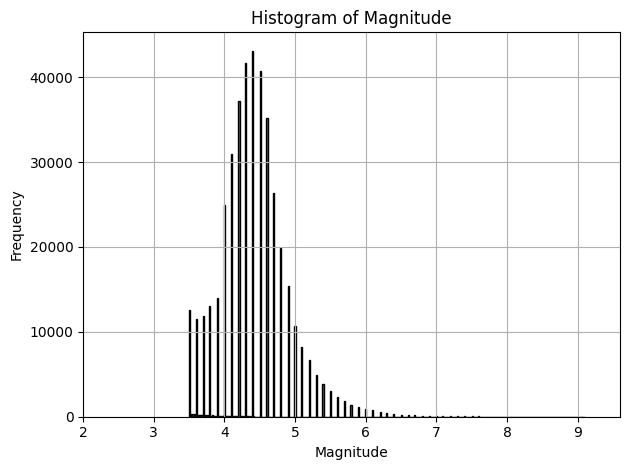

In [12]:
plot_earthquakes_mag_histogram(earthquake_db)

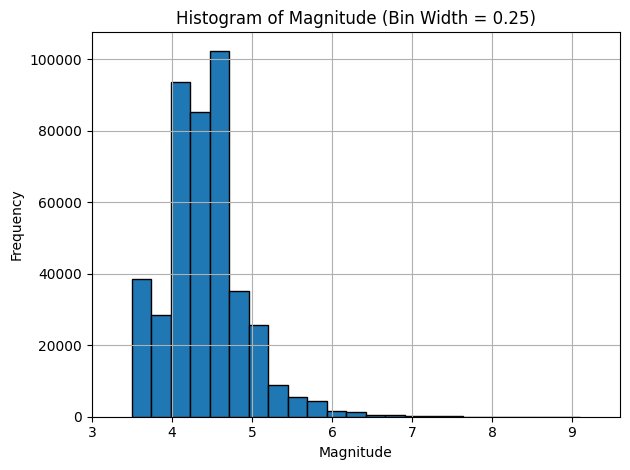

In [13]:
bin_width = 0.25
plot_earthquakes_mag_histogram_bins(earthquake_db, bin_width)

### Depth Distribution

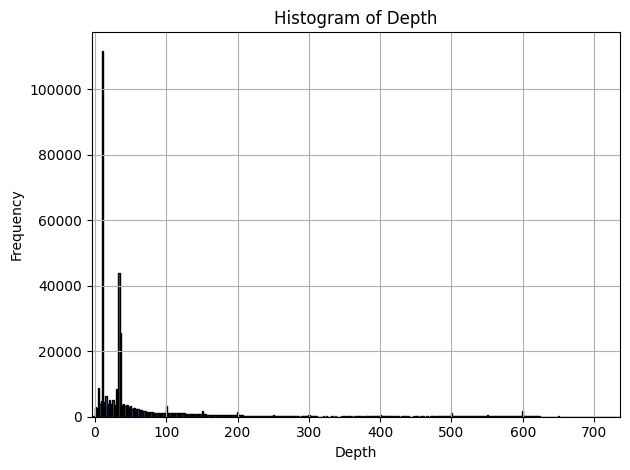

In [14]:
plot_earthquakes_depth_histogram(earthquake_db)

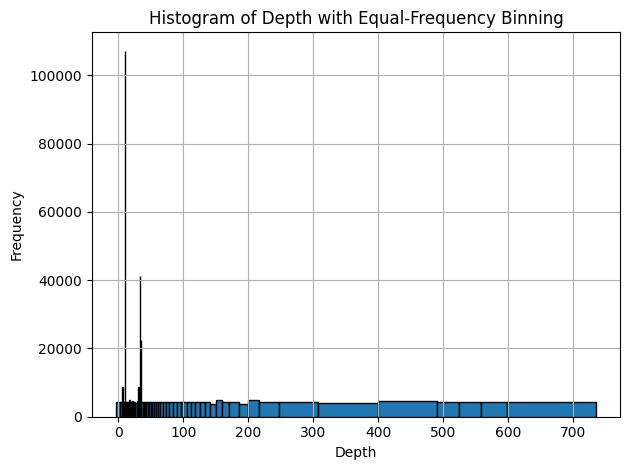

In [15]:
num_bins = 100
plot_earthquakes_depth_histogram_bins(earthquake_db, num_bins)

In [16]:
biggest_earthquakes = select_big_earthquakes(earthquake_db, n_big_earthquakes)

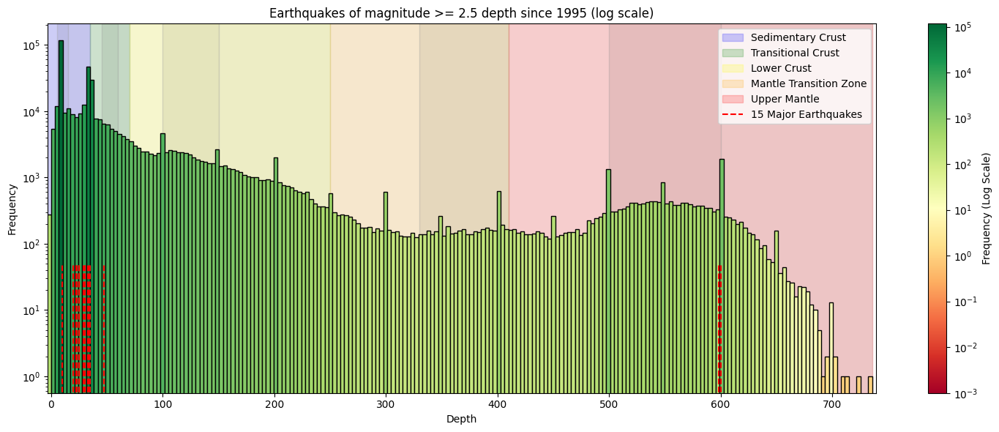

In [17]:
bin_width = 3.5
plot_earthquakes_depth_histogram_log(earthquake_db,biggest_earthquakes, threshold_year,bin_width = bin_width)

In [18]:
reduced_db, big_earthquakes_db, small_earthquakes_db, min_mag, max_mag = filter_earthquake_database(earthquake_db, threshold_year = threshold_year, min_mag = min_mag)

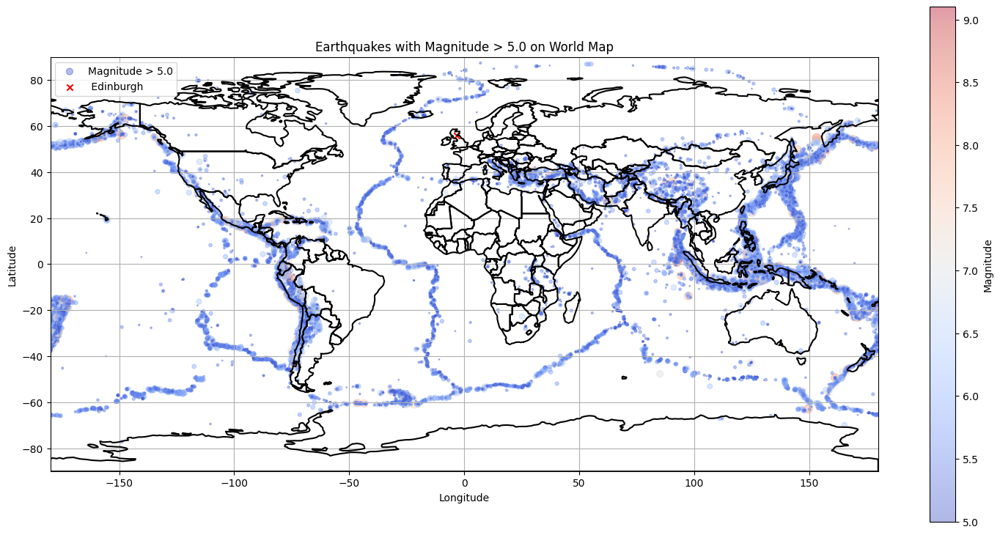

In [19]:
colormap = plt.get_cmap("coolwarm")
norm = plt.Normalize(vmin=min_mag, vmax=max_mag)
big_earthquakes_db['marker_size'] = big_earthquakes_db['normalized_mag'].apply(custom_marker_size, args=(max_mag,))
plot_earthquakes_on_worldmap(big_earthquakes_db,min_mag,colormap,norm,world, plot_world = True)

---
step 3 : earth grid

In [22]:
def create_earth_grid(power_scale = 4, step_num = 7):
    """
    We want to use cells of square shape in order to simplify the maintenance. 
    Using cells of different latiude/longitude ratio would lead to ajacent-cells
    to form a rectangle block instead of a square (which is closer to a circle)
    """

    step =  step_num/(2**power_scale)
    grid = grid_cell(step= step)    
    
    return grid, step

In [23]:
# we create the grid reprensenting the earth
grid, step = create_earth_grid(power_scale = 4, step_num = 7)

In [24]:
# we want to know to wich grid cell each earthquake belongs to
num_latitude_cells, num_longitude_cells = grid.shape[0], grid.shape[1]
earthquake_db['grid_cell'] = get_grid_cell(earthquake_db['latitude'], earthquake_db['longitude'], step)
nb_cells = num_latitude_cells*num_longitude_cells

num_latitude_cells,num_longitude_cells,nb_cells

(411, 822, 337842)

In [25]:
reduced_db, big_earthquakes_db, small_earthquakes, min_mag, max_mag = filter_earthquake_database(earthquake_db, threshold_year = threshold_year, min_mag = min_mag, depth_drop_range = depth_drop_range)

In [26]:
# we want to count the number of cells that countain big earthquakes
earthquake_density = big_earthquakes_db['grid_cell'].value_counts().reset_index() # we count how many big earthquake are located in each cell
earthquake_density.columns = ['grid_cell', 'earthquake_count']
big_shock_cells_list = big_earthquakes_db['grid_cell'].tolist()
big_shock_unique_tuples = list(set(big_shock_cells_list)) #we do not need duplicates

len(big_shock_unique_tuples), nb_cells #this gives us the number of cells that countain big earthquakes and the total number of cells

(11359, 337842)

In [27]:
# we want to know the dimensions of a grid cell
unit_area = round(earth_area/nb_cells,2)
long_lat_ratio = np.sqrt(unit_area)
hypothenus = np.sqrt(long_lat_ratio**2*2)

f'All units are in km, a cell is a square of length : {round(long_lat_ratio,2)} with an hypothenus of {round(hypothenus,2)}. The area covered by a cell is {unit_area} km²'

'All units are in km, a cell is a square of length : 38.86 with an hypothenus of 54.95. The area covered by a cell is 1509.88 km²'

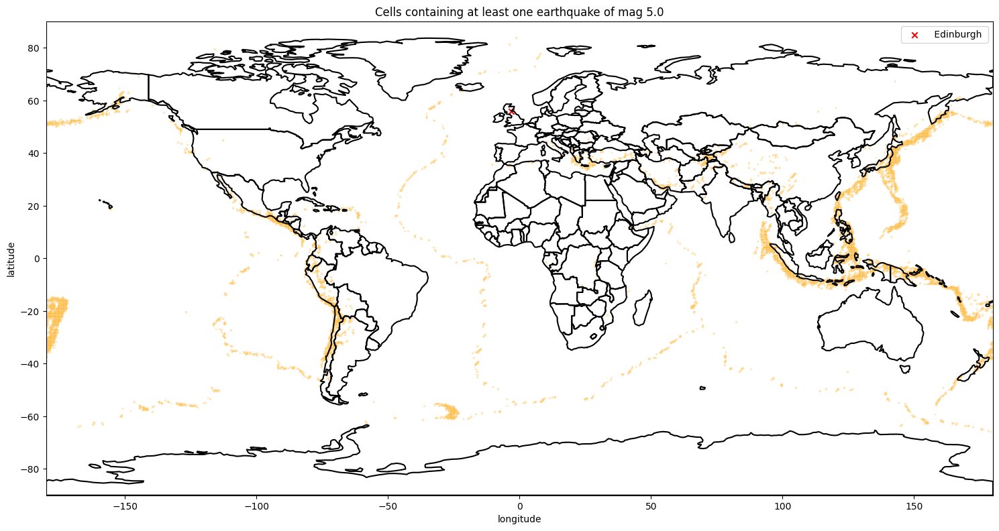

In [28]:
# we want to display cells containing at least one big earthquake
equake_areas = np.zeros_like(grid[:, :, 0], dtype=float)
plot_cells_big_earthquake(earthquake_density,big_shock_unique_tuples,grid,world, min_mag, equake_areas)

C:\Users\33626\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.10_qbz5n2kfra8p0\LocalCache\local-packages\Python310\site-packages\cartopy\io\__init__.py:241: DownloadWarning: Downloading: https://naturalearth.s3.amazonaws.com/110m_physical/ne_110m_coastline.zip
  warnings.warn(f'Downloading: {url}', DownloadWarning)


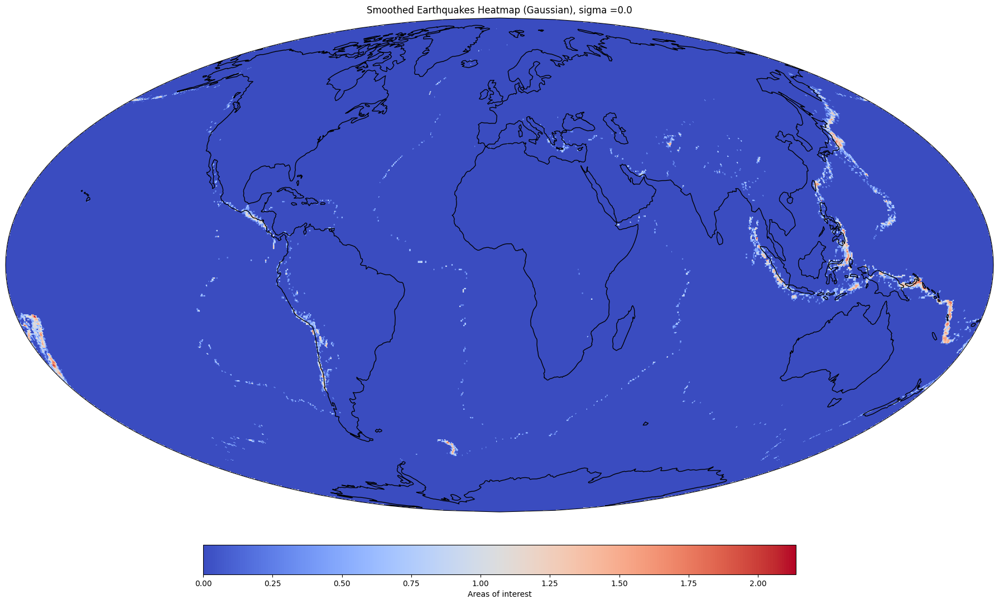

In [30]:
import cartopy.crs as ccrs

# Assuming equake_areas, min_longitude, max_longitude, min_latitude, and max_latitude are defined

fig, ax = plt.subplots(figsize=(18, 12), subplot_kw={'projection': ccrs.Mollweide()})

sigma = 0.
smoothed_heatmap = gaussian_filter(equake_areas, sigma=sigma)
im = ax.imshow(smoothed_heatmap, cmap='coolwarm', extent=[min_longitude, max_longitude, min_latitude, max_latitude], origin='lower', aspect='equal', transform=ccrs.PlateCarree())

ax.set_title(f'Smoothed Earthquakes Heatmap (Gaussian), sigma ={sigma}')

ax.set_global()
ax.coastlines()
ax.set_xlabel('Longitude')
ax.set_ylabel('Latitude')

cbar = plt.colorbar(im, ax=ax, label='Areas of interest', shrink=0.6, orientation='horizontal', pad=0.05)

plt.tight_layout()
plt.show()

Comparison with known data from:
https://www.globalquakemodel.org/product/global-seismic-risk-map

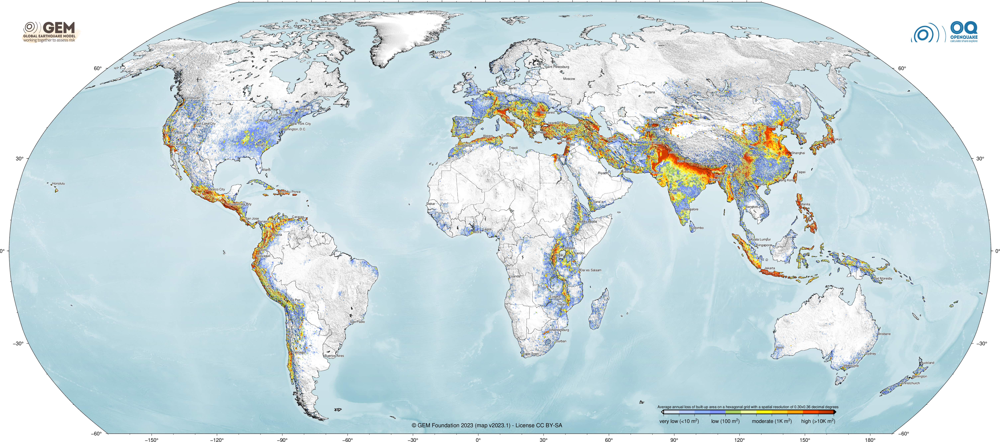

In [31]:
image_path = '../ressources/images/GEM_Global_Seismic_Risk_Map.png'
display(Image(filename=image_path))

We only use the big shocks (magnitude >= 5). Then it's normal if we dont have the exact same distribution with the colors but it's very similar.